In [103]:
import pandas as pd
import networkx as nx
import numpy as np
import topcorr
import igraph as ig
import leidenalg
import matplotlib.pyplot as plt
from bokeh.palettes import Magma
import random
from sklearn.metrics.cluster import rand_score

In [57]:
### Change to the directory of "DT_20180102_TEs_30min.csv"
data = pd.read_csv('data.csv', usecols=range(8))
data.head()

,SYM_ROOT_i,SYM_ROOT_j,DATE_dat,TE_tp_1of13_sr_1sec,TE_tp_2of13_sr_1sec,TE_tp_3of13_sr_1sec,TE_tp_4of13_sr_1sec,TE_tp_5of13_sr_1sec
0,A,AAL,20180102,0.042037,0.107633,0.036819,0.013995,0.046540
1,A,AAP,20180102,0.098099,0.137228,0.083291,0.065024,0.077509
2,A,AAPL,20180102,0.007732,0.131247,0.036731,0.014884,0.051557
3,A,ABBV,20180102,0.076981,0.135043,0.069940,0.048271,0.117341
4,A,ABC,20180102,0.094418,0.114121,0.023817,0.027778,0.085554


In [58]:
data_numpy = data.to_numpy()
graph_list = []
## Clip all negative value to 0
data_numpy[:,3:][data_numpy[:,3:] < 0] = 0

# create graph for each of the 5 time steps
for i in range(5):
    new_graph = nx.DiGraph()
    graph_data = data_numpy[:, [0,1,3+i]]
    new_graph.add_weighted_edges_from(graph_data)
    graph_list.append(new_graph)

In [71]:
firms = np.unique(data_numpy[:,0])

name_dict = {}
for i in range(len(firms)):
    name_dict[i] = firms[i]


In [76]:
# Apply edge filtering to each of the 5 time step with TMFG
filtered_graph_list = []
for i in range(5):
    adjacency = nx.adjacency_matrix(graph_list[i])
    filtered_graph = topcorr.tmfg(adjacency.todense())
    filtered_graph = nx.relabel_nodes(filtered_graph, name_dict)
    filtered_graph_list.append(filtered_graph)

In [77]:
# Create community partition using Leiden

partition_list = []
for i in range(5):
    graph = ig.Graph.from_networkx(filtered_graph_list[i])
    partition = list(leidenalg.find_partition(graph,  partition_type=leidenalg.ModularityVertexPartition))
    partition_list.append(partition)

In [6]:
# Define color for each community

def color_community(community, graph):
    color = np.array(Magma[256])
    color = np.random.RandomState(seed=10).permutation(color)
    node_color = []
    for node in graph:
        for c in range(len(community)):
            if node in community[c]:
                node_color.append(color[c])
                break
    return node_color

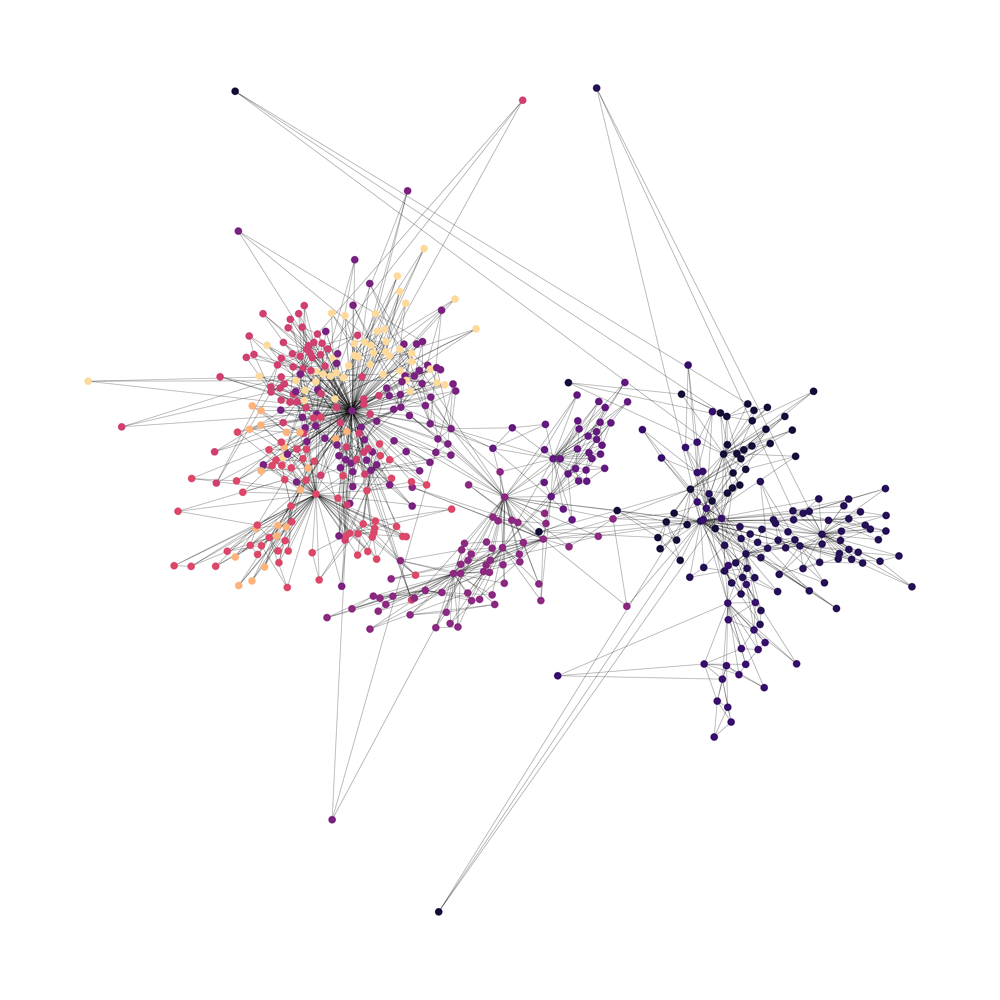

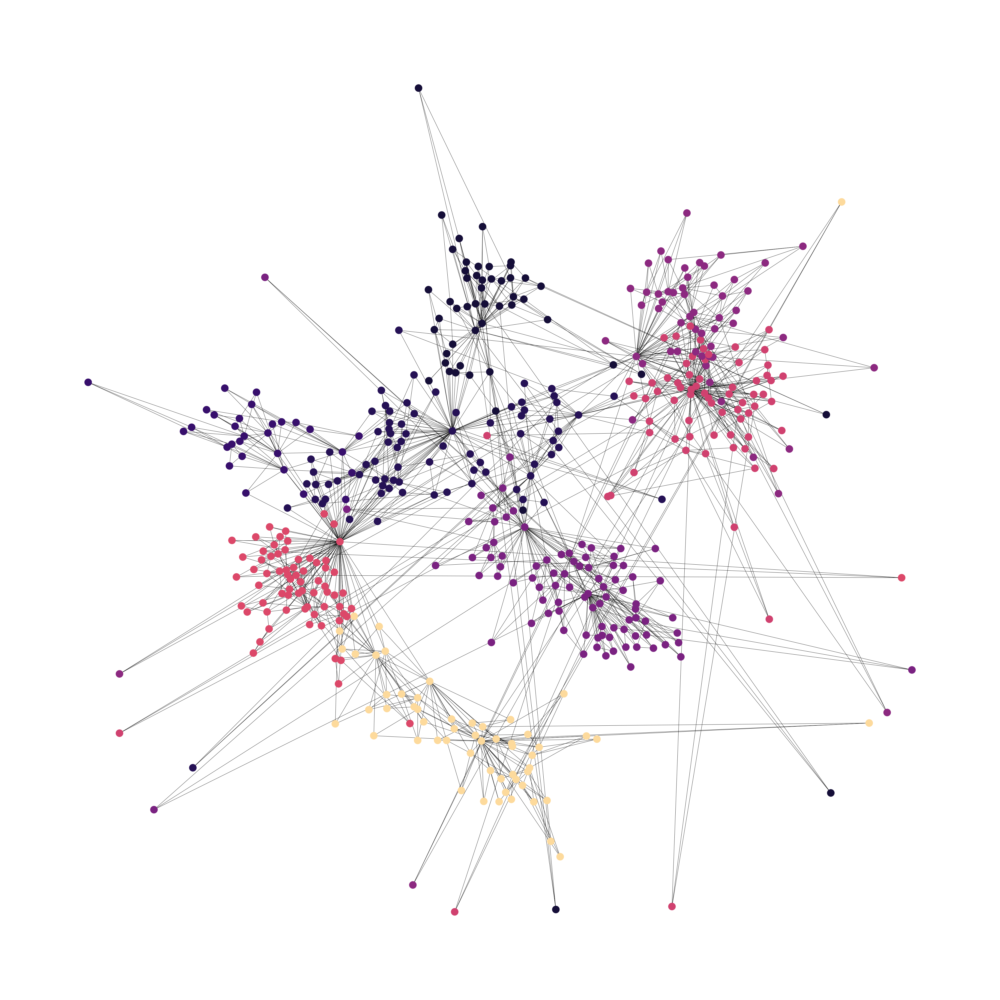

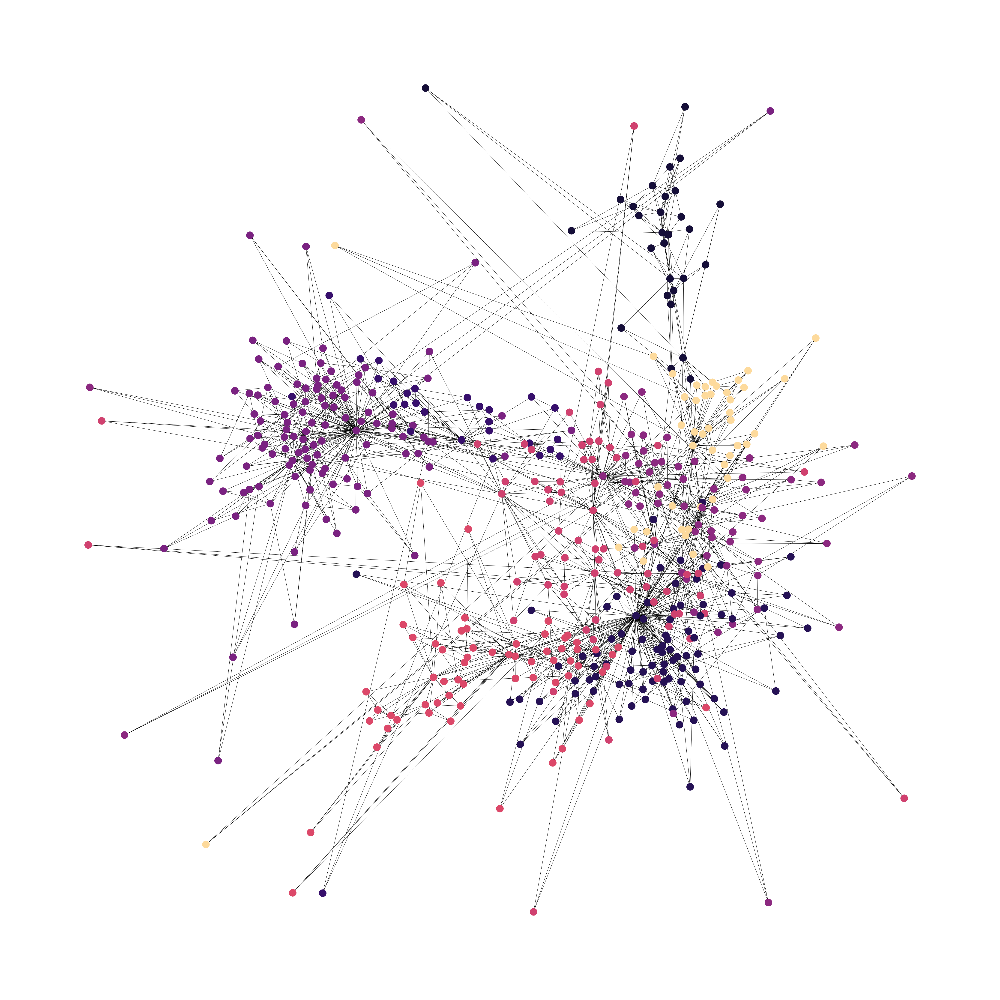

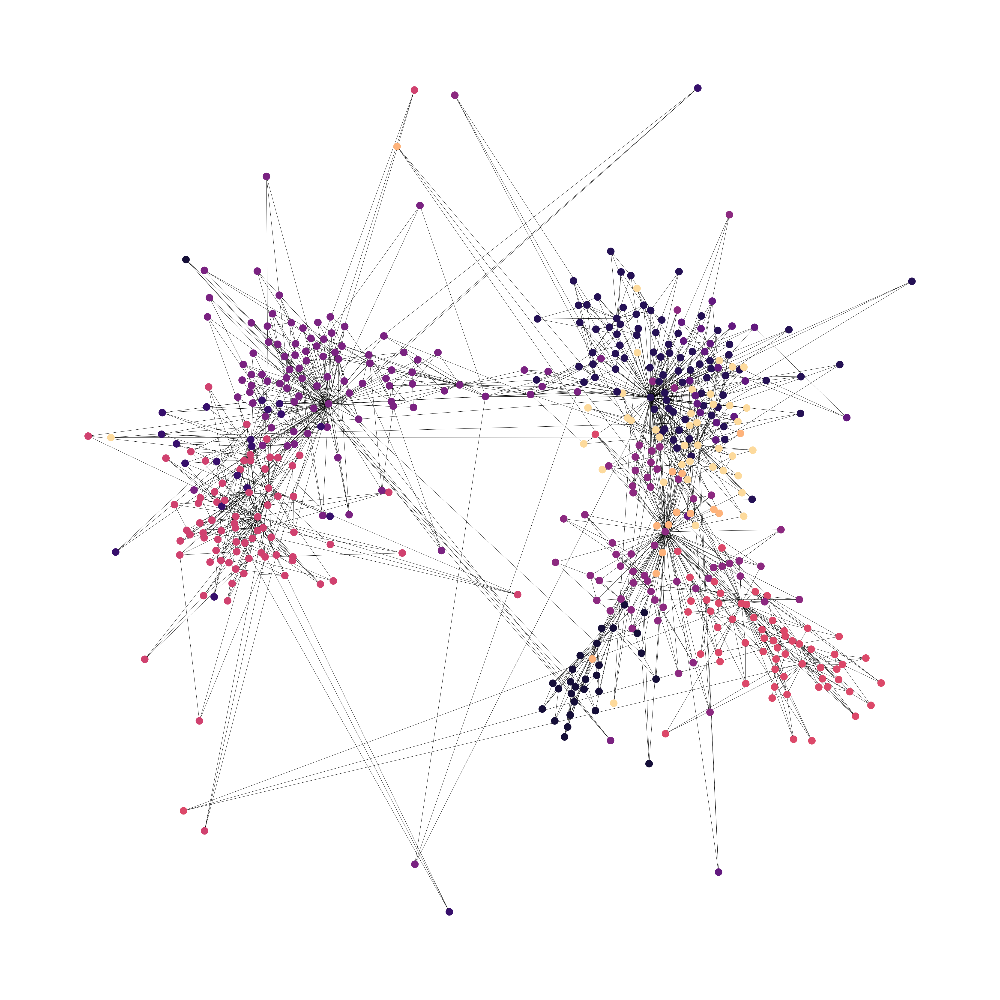

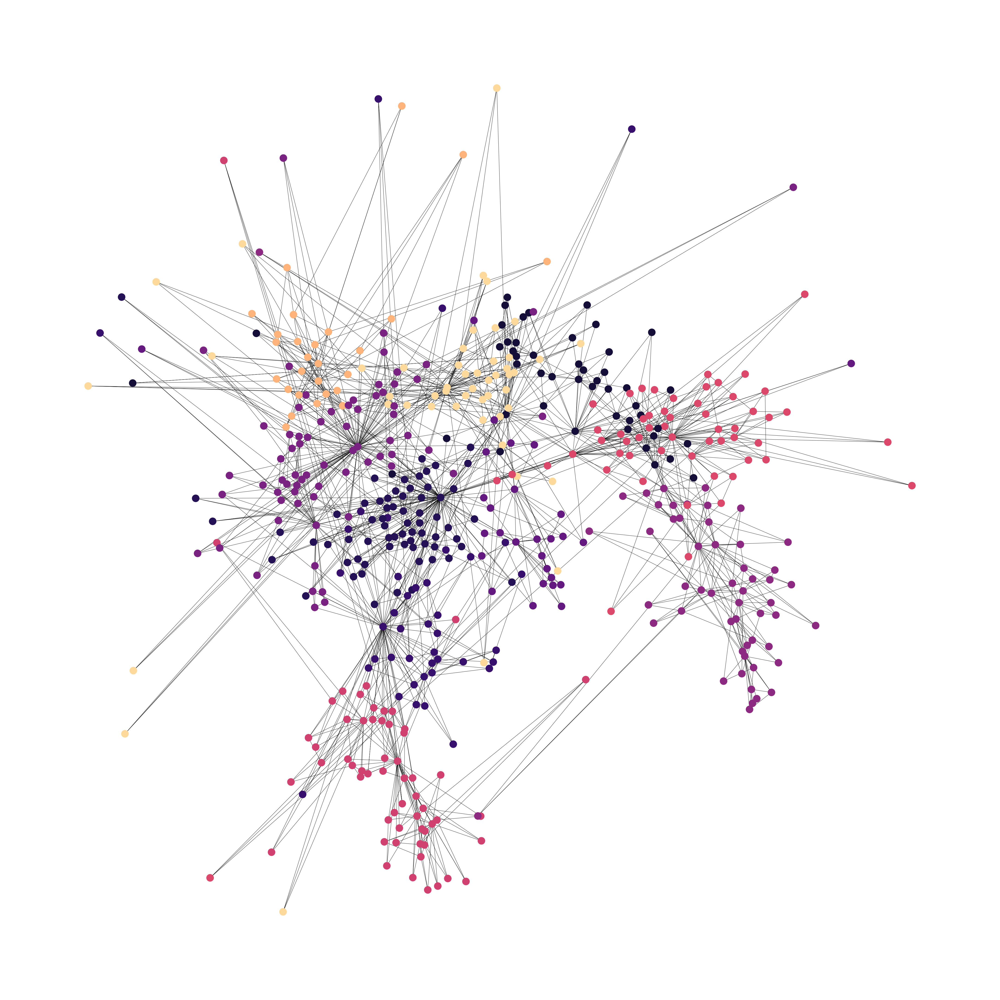

In [7]:
# Plot the graph
for i in range(5):
    graph = filtered_graph_list[i]
    community = partition_list[i]

    get_color = color_community(community, graph)


    plt.figure(i+1,figsize=(60,60))
    nx.draw(graph, node_color = get_color, node_size = 1000)
    name = f"time_step_{i+1}"
    plt.savefig(name)

In [2]:
permno = pd.read_csv('SYM_ROOT_PERMNO_CUSIP_yr_2018.csv', usecols= [0,2])
permno.head()

,PERMNO,SYM_ROOT
0,87432,A
1,87432,A
2,87432,A
3,87432,A
4,87432,A


In [26]:
permno_np = permno.to_numpy()
permno_np = permno_np[0::251,:]

permno_dict = {}
for i in permno_np:
    permno_dict[i[1]] = i[0] 

In [27]:
gvkey = pd.read_csv('gvkey_permno_fundq_2018.csv', usecols= [0,1])
gvkey.head()

,PERMNO,gvkey
0,54594,1004
1,54594,1004
2,54594,1004
3,54594,1004
4,21020,1045


In [87]:
gvkey_np = gvkey.to_numpy()
if 18035 in gvkey_np[:,0]:
    print('yes')

In [28]:
gvkey_np = gvkey.to_numpy()
gvkey_np = gvkey_np[0::4,:]

gvkey_dict = {}

for i in gvkey_np:
    gvkey_dict[i[0]] = i[1]

In [43]:
gsector =  pd.read_csv('fundq_firms_ind_yr.csv', usecols= [0,8]).fillna(-1)
gsector.head()

,gvkey,gsector
0,1004,-1.0
1,1004,-1.0
2,1004,-1.0
3,1004,-1.0
4,1004,-1.0


In [44]:
gsector_dict = {}
gsector_np = gsector.to_numpy()
for i in gsector_np:
   if i[1] != -1.0:
      gsector_dict[i[0]] = i[1]
    

In [92]:
label = []

for i in name_dict.values():
    if i not in permno_dict.keys():
        continue
    if permno_dict[i] not in gvkey_dict.keys():
        continue
    if gvkey_dict[permno_dict[i]] not in gsector_dict.keys():
        continue
    sector = gsector_dict[gvkey_dict[permno_dict[i]]]
    label.append(sector)
    

In [98]:
temp = np.zeros(len(name_dict.keys()))
temp[1] = 3

In [105]:
pred_list = []
for i in range(5):
    temp = np.zeros(len(name_dict.keys()))
    cur_time = partition_list[i]
    for j in range(len(cur_time)):
        for k in range(len(cur_time[j])):
            temp[cur_time[j][k]] = j
    pred_list.append(temp)


In [1]:
for i in range(5):
    pred = pred_list[i]
    rand_score(label, pred)